<a href="https://colab.research.google.com/github/kittypup73/Velocity-Verlet/blob/main/Velocity_Verlet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

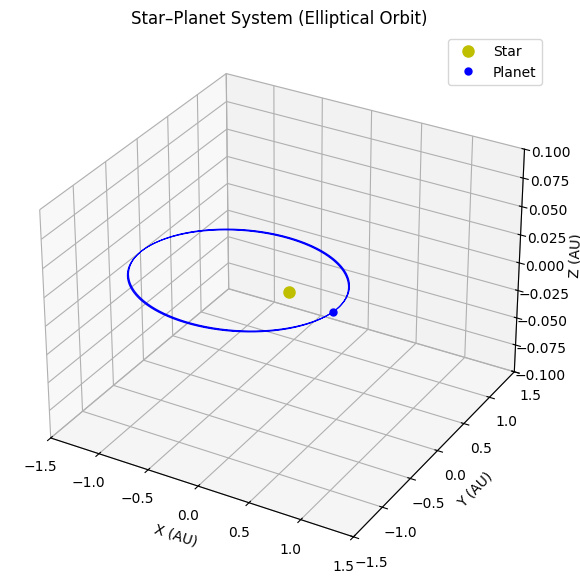

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from math import pi, sqrt

# Constants
G = 4 * pi**2  # AU^3 / (Msun * yr^2)

# Masses (solar masses)
m_star = 1.0
m_planet = 0.001

# Assign indices
masses = {1: m_star, 2: m_planet}

# Initial conditions
a_planet = 1.0      # AU
e_planet = 0.5      # eccentricity

r_peri = a_planet * (1 - e_planet)
v_peri = sqrt(G * (m_star + m_planet) * (1 + e_planet) / (a_planet * (1 - e_planet)))

# Planet at periapsis
r2 = np.array([r_peri, 0.0, 0.0])
v2 = np.array([0.0, v_peri, 0.0])

# Star at origin
r1 = np.array([0.0, 0.0, 0.0])
v1 = np.array([0.0, 0.0, 0.0])

positions = {1: r1.copy(), 2: r2.copy()}
velocities = {1: v1.copy(), 2: v2.copy()}

# Acceleration function
def compute_acc(pos, masses):
    acc = {1: np.zeros(3), 2: np.zeros(3)}
    # Body 1 acceleration due to 2
    diff = pos[2] - pos[1]
    dist3 = np.linalg.norm(diff)**3 + 1e-8
    acc[1] = G * masses[2] * diff / dist3
    # Body 2 acceleration due to 1
    diff = pos[1] - pos[2]
    dist3 = np.linalg.norm(diff)**3 + 1e-8
    acc[2] = G * masses[1] * diff / dist3
    return acc

# Integrator: Velocity Verlet
def integrate(pos, vel, masses, dt, steps):
    pos_hist = np.zeros((steps, 2, 3))
    acc = compute_acc(pos, masses)
    for t in range(steps):
        pos_hist[t,0] = pos[1]
        pos_hist[t,1] = pos[2]

        # Update positions
        pos[1] = pos[1] + vel[1]*dt + 0.5*acc[1]*dt**2
        pos[2] = pos[2] + vel[2]*dt + 0.5*acc[2]*dt**2

        # Compute new acceleration
        acc_new = compute_acc(pos, masses)

        # Update velocities
        vel[1] = vel[1] + 0.5*(acc[1] + acc_new[1])*dt
        vel[2] = vel[2] + 0.5*(acc[2] + acc_new[2])*dt

        # Prepare for next step
        acc = acc_new

    return pos_hist


# Run simulation
dt = 0.001  # years
years = 3.0
steps = int(years/dt)

pos_hist = integrate(positions, velocities, masses, dt, steps)


# Animation
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(-1.5,1.5)
ax.set_ylim(-1.5,1.5)
ax.set_zlim(-0.1,0.1)
ax.set_xlabel('X (AU)')
ax.set_ylabel('Y (AU)')
ax.set_zlabel('Z (AU)')
ax.set_title('Star–Planet System (Elliptical Orbit)')

star_line, = ax.plot([], [], [], 'yo', markersize=8, label='Star')
planet_line, = ax.plot([], [], [], 'bo', markersize=5, label='Planet')
trail_planet, = ax.plot([], [], [], 'b-', linewidth=0.6)
ax.legend()

def update(frame):
    idx = frame*10
    if idx >= steps:
        idx = steps-1

    star = pos_hist[idx,0]
    planet = pos_hist[idx,1]

    star_line.set_data([star[0]], [star[1]])
    star_line.set_3d_properties([star[2]])

    planet_line.set_data([planet[0]], [planet[1]])
    planet_line.set_3d_properties([planet[2]])

    trail_planet.set_data(pos_hist[:idx,1,0], pos_hist[:idx,1,1])
    trail_planet.set_3d_properties(pos_hist[:idx,1,2])

    return star_line, planet_line, trail_planet

from IPython.display import HTML
ani = FuncAnimation(fig, update, frames=steps//10, interval=20, blit=True)
HTML(ani.to_jshtml())